This notebook generates a 'fake' diopsis image. The image contains a specified amount of insect and dirt crops that are pasted onto a user specified base image. These images can be used to visualize the performance of the main pipeline in talks or presentations.

In [1]:
import os
import random
from PIL import Image, ImageDraw

In [12]:
def paste_random_objects(
    base_image_path, dirt_folder, insect_folder, output_path, num_dirt, num_insects,
    num_dirt_with_border=0, num_insects_with_border=0, border_thickness=1, random_seed=None,
    positions=None, paste_chance = 1, transparent_base = False):
    """
    Paste randomly selected dirt and insect images onto a base image with minimal overlap.
    If an image cannot be placed, a new random image is selected. If placement still fails, the image is resized.

    Returns:
    - Image object with pasted images.
    - Updated positions dictionary for reuse.
    """
    def filter_small_images(image_paths, max_width, max_height):
        """Filter images that are smaller than 25% of base image size."""
        valid_images = []
        for img_path in image_paths:
            img = Image.open(img_path)
            img_width, img_height = img.size
            if img_width <= max_width and img_height <= max_height:
                valid_images.append(img_path)
        return valid_images
    
    border_color = "cyan"
    if random_seed is not None:
        random.seed(random_seed)

    # Load the base image
    base_img = Image.open(base_image_path).convert("RGBA")
    if transparent_base:
        base_img = Image.new("RGBA", base_img.size, (0, 0, 0, 0))
    base_width, base_height = base_img.size
    max_width = base_width * 0.25
    max_height = base_height * 0.25

    # Get list of images from folders
    dirt_images = [os.path.join(dirt_folder, f) for f in os.listdir(dirt_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]
    dirt_images = filter_small_images(dirt_images, max_width, max_height)
    insect_images = [os.path.join(insect_folder, f) for f in os.listdir(insect_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]

    # Ensure previously placed images are always included
    if positions is not None:
        selected_dirt = list(set(random.sample(dirt_images, min(num_dirt, len(dirt_images))) + list(positions.keys())))
        selected_insects = list(set(random.sample(insect_images, min(num_insects, len(insect_images))) + list(positions.keys())))
    else:
        # Select initial random images
        selected_dirt = random.sample(dirt_images, min(num_dirt, len(dirt_images)))
        selected_insects = random.sample(insect_images, min(num_insects, len(insect_images)))

    # Randomly pick images that will get a border
    dirt_with_border = set(random.sample(selected_dirt, min(num_dirt_with_border, len(selected_dirt))))
    insects_with_border = set(random.sample(selected_insects, min(num_insects_with_border, len(selected_insects))))

    # Initialize positions dictionary if not provided
    if positions is None:
        positions = {}

    occupied_regions = [(x, y, width, height) for x, y, width, height in positions.values()]  # Ensure correct format

    def find_non_overlapping_position(img_width, img_height):
        """Find a random position ensuring minimal overlap."""
        max_attempts = 50
        for _ in range(max_attempts):
            x = random.randint(0, base_width - img_width)
            y = random.randint(0, base_height - img_height)

            # Check overlap
            overlap = any(
                (x < ox + ow and x + img_width > ox and y < oy + oh and y + img_height > oy)
                for ox, oy, ow, oh in occupied_regions
            )
            if not overlap:
                occupied_regions.append((x, y, img_width, img_height))
                return x, y
        return None  # No available position found

    def ensure_image_pasting(img_list, with_border_set, paste_chance):
        """Try to paste all images. If placement fails, redraw another image or resize."""
        pasted_images = []  # Keep track of successfully pasted images
        overlaps = 0
        skipped = 0
        while img_list:
            img_path = img_list.pop(0)  # Get the first image in the list

            overlay = Image.open(img_path).convert("RGBA")
            overlay_width, overlay_height = overlay.size

            retry_count = 0
            max_retries = 15  # Max retries per image before resizing

            while retry_count < max_retries:
                if img_path not in positions:
                    position = find_non_overlapping_position(overlay_width, overlay_height)
                    if position:
                        x, y = position
                        positions[img_path] = [x, y, overlay_width, overlay_height]  # Save new position
                        break  # Stop retrying since position is found
                
                retry_count += 1

                # If placement failed, pick a new image from the same category
                if retry_count < max_retries and img_list:
                    img_path = random.choice(img_list)
                    overlay = Image.open(img_path).convert("RGBA")
                    overlay_width, overlay_height = overlay.size

            # If placement still failed, resize the image
            if img_path not in positions:
                overlay = overlay.resize((overlay_width // 3, overlay_height // 3))
                overlay_width, overlay_height = overlay.size
                position = find_non_overlapping_position(overlay_width, overlay_height)

                if position:
                    positions[img_path] = position
                else:
                    overlaps += 1
                    x = random.randint(0, base_width - overlay_width)
                    y = random.randint(0, base_height - overlay_height)
                    positions[img_path] = [x, y, overlay_width // 3, overlay_height // 3]
                    #continue  # Skip this image if all attempts fail

            # Paste the image
            x, y, *_ = positions[img_path]
            if img_path in with_border_set:
                # Create a new image with border
                bordered_img = Image.new("RGBA", (overlay_width + 2 * border_thickness, overlay_height + 2 * border_thickness), (0, 0, 0, 0))
                bordered_img.paste(overlay, (border_thickness, border_thickness))

                # Draw border
                draw = ImageDraw.Draw(bordered_img)
                draw.rectangle([0, 0, bordered_img.width - 1, bordered_img.height - 1], outline=border_color, width=border_thickness)

                # Paste bordered image
                if random.random() < paste_chance:
                    base_img.paste(bordered_img, (x - border_thickness, y - border_thickness), bordered_img)
                else:
                    skipped += 1
                
            else:
                if random.random() < paste_chance:
                    base_img.paste(overlay, (x, y), overlay)
                else:
                    skipped += 1

            pasted_images.append(img_path)  # Track successfully pasted images

        print(f"{len(pasted_images)} images pasted")
        return overlaps, skipped  # Return list of successfully pasted images

    # Ensure all dirt and insect images get pasted
    overlaps, skipped = ensure_image_pasting(selected_dirt, dirt_with_border, paste_chance)
    overlaps, skipped = ensure_image_pasting(selected_insects, insects_with_border, paste_chance)

    # Save the final image
    base_img.save(output_path)
    print(f"{overlaps} overlap cases.")
    print(f"{skipped} images skipped.")
    return base_img, positions

0 images pasted
1000 images pasted
28 overlap cases.
674 images skipped.


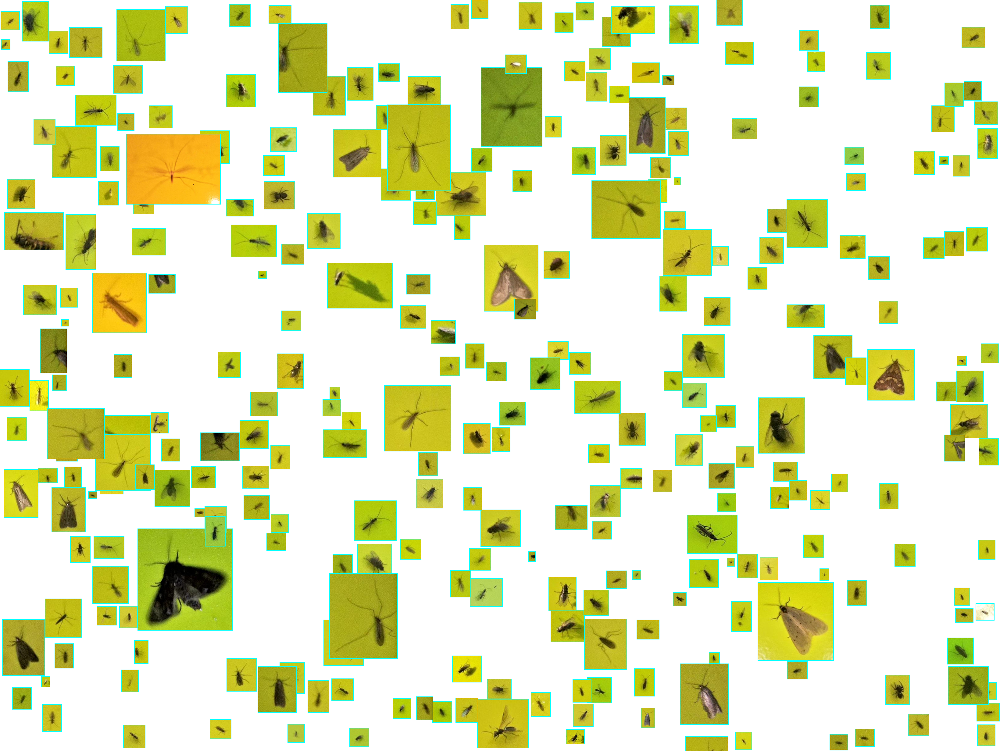

In [13]:
# Random seed 1000 insects: 19
# Example usage:
base_image_path = "/Volumes/Apollo/Diopsis_Cameras/RESULTS_2024/Images_RAW_and_analyzed/385_Weiss_up/DIOPSIS-385_analyzed/photos/20240713/20240713180303.jpg"
dirt_folder = "/Volumes/Apollo/Diopsis_Cameras/Train_Test_datasets/Apollo_dirt_classifier/dirt_test_new/no_insect"
insect_folder = "/Volumes/Apollo/Diopsis_Cameras/Train_Test_datasets/Apollo_dirt_classifier/dirt_test_new/insect"
output_path = "/Volumes/Apollo/Davos/Präsis/Visualizations/Insects_missed.png"
#paste_random_objects(base_image_path, dirt_folder, insect_folder, output_path, num_dirt = 50, num_insects = 300)
base_img, positions = paste_random_objects(
    base_image_path, dirt_folder, insect_folder, output_path, 
    num_dirt = 0, num_insects = 1000,
    num_dirt_with_border=0, num_insects_with_border=1000, border_thickness=2,
    random_seed = 20, paste_chance = 0.322, transparent_base = True)
base_img


676 images pasted
0 images pasted
0 overlap cases.
0 images skipped.


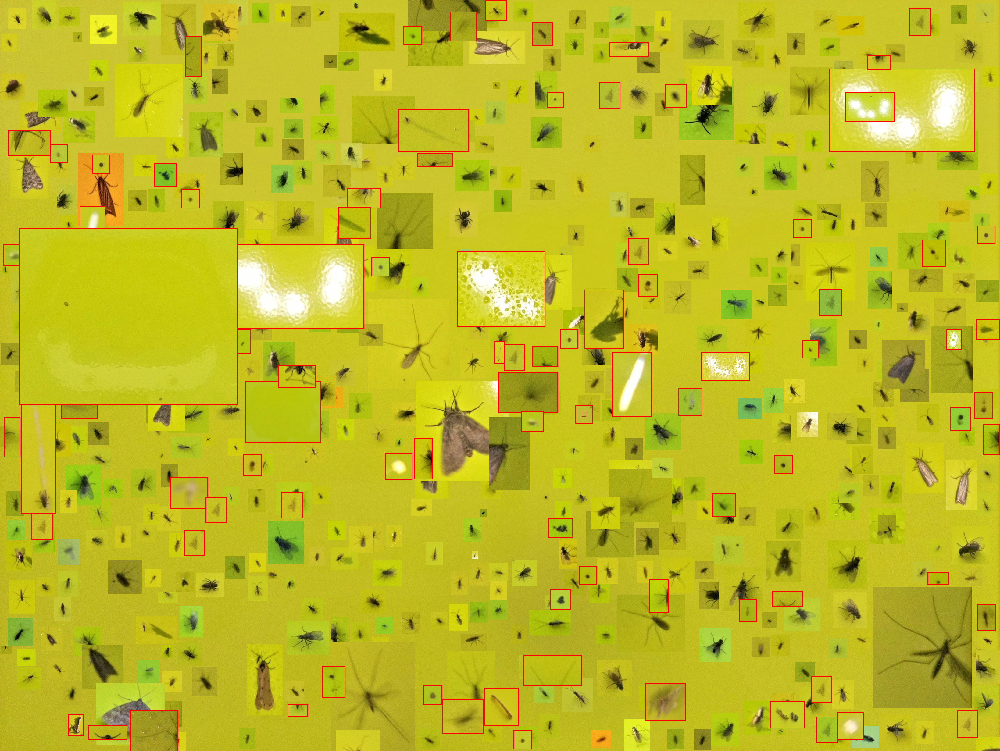

In [9]:
#base_image_path = "/Volumes/Apollo/Diopsis_Cameras/RESULTS_2024/Images_RAW_and_analyzed/385_Weiss_up/DIOPSIS-385_analyzed/photos/20240713/20240713180303.jpg"
base_image_path = "/Volumes/Apollo/Davos/Präsis/Visualizations/Insects_after_Dirt_errors.png"
dirt_folder = "/Volumes/Apollo/Diopsis_Cameras/Train_Test_datasets/Apollo_dirt_classifier/dirt_test_new/no_insect"
insect_folder = "/Volumes/Apollo/Diopsis_Cameras/Train_Test_datasets/Apollo_dirt_classifier/dirt_test_new/insect"
output_path = "/Volumes/Apollo/Davos/Präsis/Visualizations/Result_without_FN.png"
base_img, positions = paste_random_objects(
    base_image_path, dirt_folder, insect_folder, output_path, 
    num_dirt = 676, num_insects = 0,
    num_dirt_with_border=676, num_insects_with_border=0, border_thickness=3,
    random_seed = 5, paste_chance = 0.1547)
base_img